# IMPORTING RELEVANT LIBRARIES, LOADING MODEL

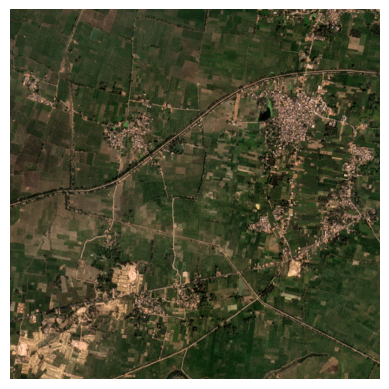

In [1]:
from PIL import Image
import matplotlib.pyplot as plt

# Path to your .tif file
tif_path = "/home/patel_zeel/kiln_compass_24/data/bihar/images/9306974_2910108.tif"

# Open and display the image
img = Image.open(tif_path)
plt.imshow(img)
plt.axis('off')
plt.show()

In [2]:
import os

import rasterio
# import shapely.geometry
import geojson

from PIL import Image
from transformers import AutoProcessor, AutoModelForCausalLM 

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import spec_defs

# from garuda import obb_to_aa

import torch
import torchvision.transforms as transforms
if torch.cuda.is_available():
    device = torch.device("cuda:3")
else:
    device = torch.device("cpu")
    print("CUDA is not available, using CPU")

model1 = AutoModelForCausalLM.from_pretrained("microsoft/Florence-2-large", trust_remote_code=True, torch_dtype='auto').eval().to(device)
processor1 = AutoProcessor.from_pretrained("microsoft/Florence-2-large", trust_remote_code=True)

torch_dtype = torch.float16 if torch.cuda.is_available() else torch.float32

In [3]:
model2 = AutoModelForCausalLM.from_pretrained("microsoft/Florence-2-large", trust_remote_code=True, torch_dtype='auto').eval().to(device)
processor2 = AutoProcessor.from_pretrained("microsoft/Florence-2-large", trust_remote_code=True)

# DEFINING FUNCTIONS

In [4]:
def zero_shot_bbox(image_path, label_path, task, text):
    metadata_path = "/home/patel_zeel/kiln_compass_24/data/lucknow_airshed/metadata.geojson"
    with open(metadata_path) as f:
        metadata = geojson.load(f) # loading metadat
    image_tensor,label_tensor, image_metadata = spec_defs.load_image_and_label(image_path, label_path, metadata) # loading image and labels
    image_np = image_tensor.permute(1, 2, 0).cpu().numpy() # creating np array of image
    height, width, _ = image_np.shape # finding height and width of image in pixels
    image = Image.fromarray((image_np * 255).astype(np.uint8))  # Convert back to 8-bit per channel
    text_prompt = task + text # creating prompt to give to model
    inputs = processor1(text = text_prompt, images=image, return_tensors="pt").to(device, torch_dtype) # giving input to model
    generated_ids = model1.generate(
        input_ids=inputs["input_ids"],
        pixel_values=inputs["pixel_values"],
        max_new_tokens=4096,
        num_beams=3,
        do_sample=False
    )
    generated_text = processor1.batch_decode(generated_ids, skip_special_tokens=False)[0] # model output
    od_parsed = processor1.post_process_generation(generated_text, task=task, image_size=(image.width, image.height))
    # print(od_parsed)
    model_op = od_parsed[task] # relevant portion of model output
    print(model_op) #
    op_bboxes = model_op['bboxes'] # bounding boxes in [xmin, ymin, xmax, ymax] format
    if task == "<OPEN_VOCABULARY_DETECTION>":
        op_labels = model_op['bboxes_labels'] # labels
    else:
        op_labels = model_op['labels'] #labels
    return image, op_labels, op_bboxes, label_tensor, image_metadata, height, width

In [5]:
def box_area(box): # box in [xmin, ymin, xmax, ymax] format
    return (box[2] - box[0]) * (box[3] - box[1]) # calculating area

def convert_to_xyxy(box, h_im, w_im): # box: [label, x_center, y_center, width, height], YOLO aa format
    x_center, y_center, width, height = box[1], box[2], box[3], box[4]
    x_min = (x_center - width / 2) * w_im # scaling to image size
    y_min = (y_center - height / 2) * h_im
    x_max = (x_center + width / 2) * w_im
    y_max = (y_center + height / 2) * h_im
    return [x_min, y_min, x_max, y_max]

def calc_iou(box_a, box_b, h_im, w_im):
    if len(box_b) > 4: # box_b is in YOLO aa format [label, x_center, y_center, width, height]
        box_b = convert_to_xyxy(box_b, h_im, w_im)
    box_a = np.array(box_a)
    box_b = np.array(box_b)
    
    area_a = box_area(box_a)
    area_b = box_area(box_b)
    
    top_left = np.maximum(box_a[:2], box_b[:2]) # finding overlap
    bottom_right = np.minimum(box_a[2:], box_b[2:])
    area_inter = np.prod(np.clip(bottom_right - top_left, a_min=0, a_max=None))
    
    return abs(area_inter) / (abs(area_a) + abs(area_b) - abs(area_inter))

In [6]:
def zero_shot_bbox_ft(image_path, label_path, task, text):
    metadata_path = "/home/patel_zeel/kiln_compass_24/data/lucknow_airshed/metadata.geojson"
    with open(metadata_path) as f:
        metadata = geojson.load(f) # loading metadat
    image_tensor,label_tensor, image_metadata = spec_defs.load_image_and_label(image_path, label_path, metadata) # loading image and labels
    image_np = image_tensor.permute(1, 2, 0).cpu().numpy() # creating np array of image
    height, width, _ = image_np.shape # finding height and width of image in pixels
    image = Image.fromarray((image_np * 255).astype(np.uint8))  # Convert back to 8-bit per channel
    text_prompt = task + text # creating prompt to give to model
    inputs = processor2(text = text_prompt, images=image, return_tensors="pt").to(device, torch_dtype) # giving input to model
    generated_ids = model2.generate(
        input_ids=inputs["input_ids"],
        pixel_values=inputs["pixel_values"],
        max_new_tokens=4096,
        num_beams=3,
        do_sample=False
    )
    generated_text = processor2.batch_decode(generated_ids, skip_special_tokens=False)[0] # model output
    od_parsed = processor2.post_process_generation(generated_text, task=task, image_size=(image.width, image.height))
    # print(od_parsed)
    model_op = od_parsed[task] # relevant portion of model output
    print(model_op) #
    op_bboxes = model_op['bboxes'] # bounding boxes in [xmin, ymin, xmax, ymax] format
    if task == "<OPEN_VOCABULARY_DETECTION>":
        op_labels = model_op['bboxes_labels'] # labels
    else:
        op_labels = model_op['labels'] #labels
    return image, op_labels, op_bboxes, label_tensor, image_metadata, height, width

In [7]:
def match_boxes(pred_boxes, gt_boxes, h_im, w_im, iou_threshold):
    matches =[]
    gt_kilns = [0]*len(gt_boxes)
    for pred in pred_boxes:
        for i, gt in enumerate(gt_boxes): # iterating over gt boxes
            iou_score = calc_iou(pred, gt, h_im, w_im) # calc iou score
            if iou_score >= iou_threshold: # checking for overlap
                matches.append((pred, gt_boxes[i])) # mark as correct prediction
                gt_kilns[i] = 1
    kilns_found = 0
    for i in gt_kilns:
        if i==1:
            kilns_found += 1
    return matches, kilns_found

In [8]:
def compare_gt_pred(image_path, aa_label_path, task, text, iou_th, plot_results = False):
    image, op_labels, pred_boxes, label_tensor, image_metadata, height, width = zero_shot_bbox(image_path, aa_label_path, task, text)
    with open(aa_label_path):
        gt_boxes = np.loadtxt(aa_label_path, ndmin=2)

    matched_pairs, kilns_found = match_boxes(pred_boxes, gt_boxes, height, width, iou_th)
    gt_num = len(gt_boxes)
    pred_num = len(pred_boxes)
    num_corr = len(matched_pairs)

    # prec = num_corr/pred_num
    # rec = num_corr/gt_num
    # f1 = 2/((1/prec)+(1/rec))

    if plot_results == True:
        fig, ax = plt.subplots(1, 2, figsize=(10, 5)) # creating 2 plots, one for actual, one for predicted

        ax[0].imshow(image)
        for bbox in gt_boxes:
            bbox_f = convert_to_xyxy(bbox, height, width)
            x1, y1, x2, y2 = bbox_f
            # print(bbox_f)
            rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1, edgecolor='b', facecolor='none')
            ax[0].add_patch(rect)  # Add the rectangle to the Axes         
        
        ax[1].imshow(image)
        for bbox, label in zip(pred_boxes, op_labels): 
            x1, y1, x2, y2 = bbox 
            rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1, edgecolor='r', facecolor='none')
            ax[1].add_patch(rect)  # Add the rectangle to the Axes 
            plt.text(x1, y1, label, color='white', fontsize=8, bbox=dict(facecolor='red', alpha=0.5))   # label    
 
        ax[0].axis('off')  
        ax[1].axis('off') 
        plt.show()
    return gt_num, pred_num, num_corr, kilns_found

# IMAGES, LABELS AND PROMPTS

In [9]:
images_folder = "/home/rishabh.mondal/Brick-Kilns-project/ijcai_2025_kilns/data/vlm_data/lucknow_airshed_most_15/images"
labels_folder = "/home/rishabh.mondal/Brick-Kilns-project/ijcai_2025_kilns/data/vlm_data/lucknow_airshed_most_15/labels"
aa_labels_folder = "/home/nupoor.assudani/cs299_main/lucknow_airshed_most_15_aa_labels"
image_names = ['8988385_3137890.tif', '8999392_3085607.tif', '9021406_3113124.tif', '9029661_3107621.tif',
               '9035164_3091111.tif', '8988385_3140642.tif', '9002144_3118628.tif', '9021406_3115876.tif',
               '9032413_3107621.tif', '9037916_3088359.tif', '8999392_3082855.tif', '9004895_3118628.tif',
               '9024157_3085607.tif', '9035164_3088359.tif', '9040668_3088359.tif']
label_names = []
for name in image_names:
    label_names.append(name[:-4]+'.txt')

In [7]:
tap1 = "<OD>"
tep1 = ""
tap2 = "<OPEN_VOCABULARY_DETECTION>"
tep2 = "brick kiln with chimney"
tap3 = "<OPEN_VOCABULARY_DETECTION>"
tep3 = "chimneys and brick kilns"
tap4 = "<OPEN_VOCABULARY_DETECTION>"
tep4 = "Aerial view of multiple brick kilns in operation, some oval and others circular, all emitting smoke. The kilns are close together, surrounded by fields, roads, and vegetation."
tap5 = "<OPEN_VOCABULARY_DETECTION>"
tep5 = "top-down satellite image of an oval-shaped brick kiln."
tap6 = "<OPEN_VOCABULARY_DETECTION>"
tep6 = "An oval-shaped traditional brick kiln in a vast rural area."
tap7 = "<OPEN_VOCABULARY_DETECTION>"
tep7 = "brick kilns"
tap8 = "<CAPTION_TO_PHRASE_GROUNDING>"
tep8 = "Aerial view of multiple brick kilns in operation, some oval and others circular, all emitting smoke. The kilns are close together, surrounded by fields, roads, and vegetation."
tap9 = "<CAPTION_TO_PHRASE_GROUNDING>"
tep9 = "An oval-shaped traditional brick kiln in a vast rural area."
tap10 = "<CAPTION_TO_PHRASE_GROUNDING>"
tep10 = "top-down satellite image of an oval-shaped brick kiln."
tap11 = "<CAPTION_TO_PHRASE_GROUNDING>"
tep11 = "brick kilns in a rural area"
tap12 = "<CAPTION_TO_PHRASE_GROUNDING>"
tep12 = "brick kilns with chimneys"
tap13 = "<CAPTION_TO_PHRASE_GROUNDING>"
tep13 = "fields, factory, roads and brick kilns"
tap14 = "<CAPTION_TO_PHRASE_GROUNDING>"
tep14 = "Satellite image of rural area with factories, trees, fields, brick kilns with chimneys and roads"
tap15 = "<CAPTION_TO_PHRASE_GROUNDING>"
tep15 = "chimneys and brick kilns"

task_prompts = [tap1, tap2, tap3, tap4, tap5, tap6, tap7, tap8, tap9, tap10, tap11, tap12, tap13, tap14, tap15]
text_prompts = [tep1, tep2, tep3, tep4, tep5, tep6, tep7, tep8, tep9, tep10, tep11, tep12, tep13, tep14, tep15]

# TESTING

Text prompt: <CAPTION_TO_PHRASE_GROUNDING>satellite image showing fields, factories, roads, a river, and brick kilns
{'bboxes': [[2.240000009536743, 2.240000009536743, 638.3999633789062, 638.3999633789062], [2.240000009536743, 1.5999999046325684, 638.3999633789062, 639.0399780273438], [222.39999389648438, 450.8800048828125, 272.32000732421875, 507.1999816894531]], 'labels': ['satellite image', 'fields', 'brick kilns']}


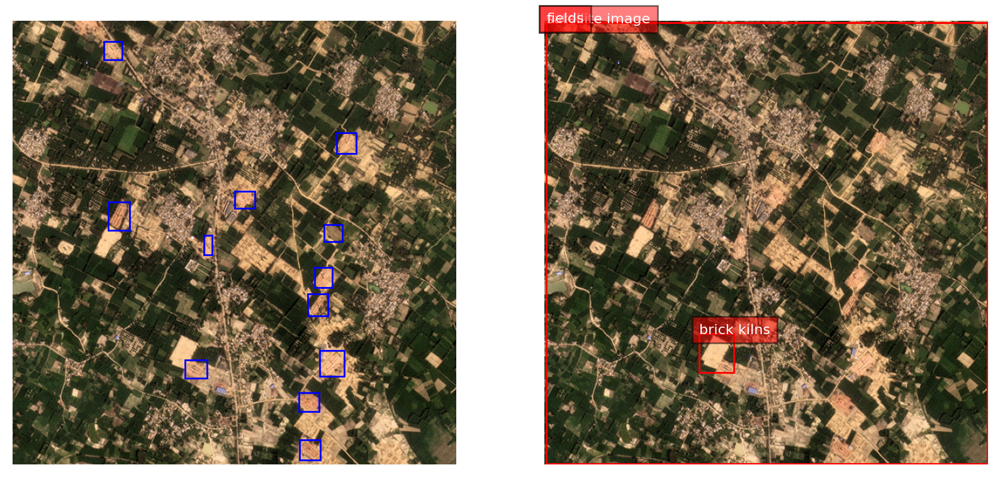

{'bboxes': [[2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [2.240000009536743, 2.240000009536743, 639.0399780273438, 639.0399780273438], [1.5999999046325684, 1.5999999046325684, 220.47999572753906, 452.1600036621094], [155.83999633789062, 383.03997802734375, 294.0799865722656, 495.03997802734375]], 'labels': ['satellite image', 'fields', 'roads', 'brick kilns']}


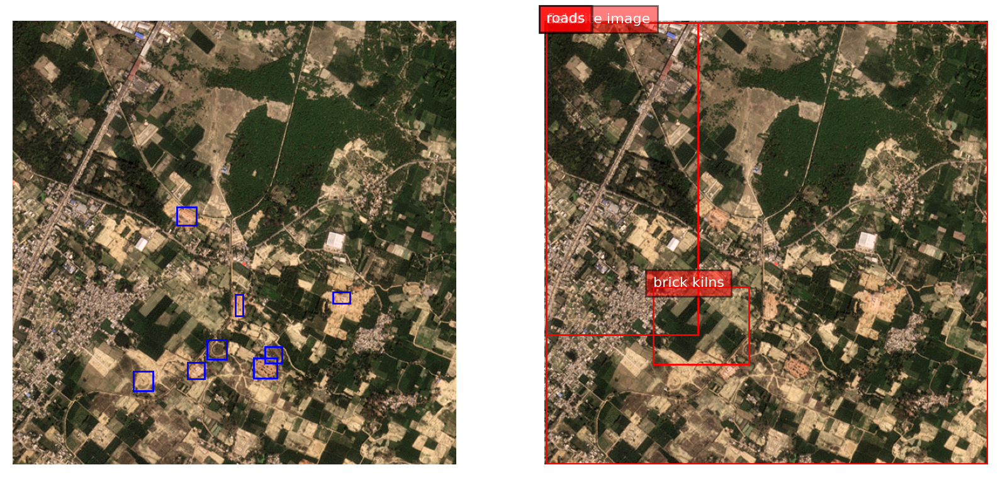

{'bboxes': [[2.240000009536743, 2.240000009536743, 638.3999633789062, 638.3999633789062], [2.240000009536743, 1.5999999046325684, 638.3999633789062, 639.0399780273438], [267.8399963378906, 185.27999877929688, 356.1600036621094, 324.1600036621094]], 'labels': ['satellite image', 'fields', 'brick kilns']}


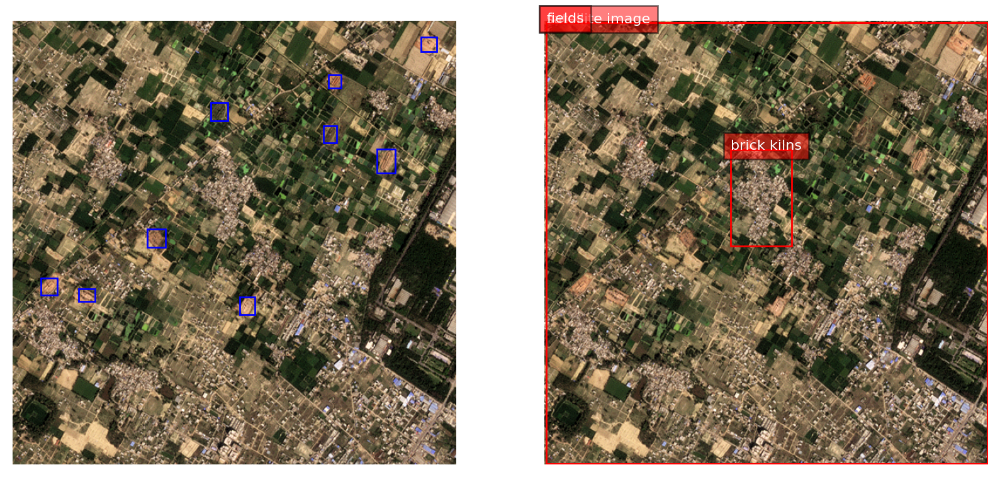

{'bboxes': [[2.240000009536743, 2.879999876022339, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.240000009536743, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.240000009536743, 639.0399780273438, 638.3999633789062], [2.240000009536743, 329.2799987792969, 638.3999633789062, 372.79998779296875], [2.879999876022339, 357.44000244140625, 372.79998779296875, 639.0399780273438], [352.9599914550781, 292.1600036621094, 389.44000244140625, 336.32000732421875]], 'labels': ['satellite image', 'fields', 'factories', 'roads', 'a river', 'brick kilns']}


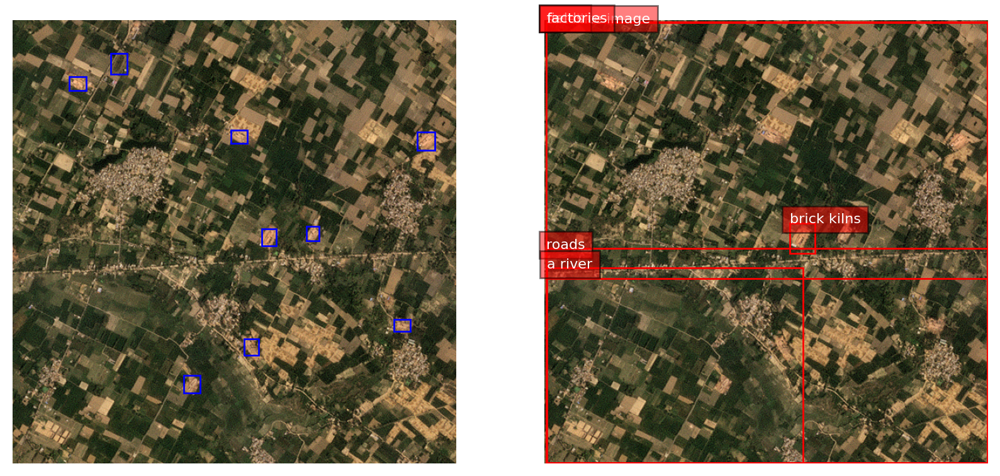

{'bboxes': [[2.240000009536743, 3.5199999809265137, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.879999876022339, 638.3999633789062, 638.3999633789062], [253.1199951171875, 198.0800018310547, 299.1999816894531, 246.72000122070312], [2.240000009536743, 32.31999969482422, 639.0399780273438, 465.5999755859375], [82.87999725341797, 299.1999816894531, 136.63999938964844, 347.8399963378906], [174.39999389648438, 464.9599914550781, 214.72000122070312, 509.1199951171875], [199.36000061035156, 520.0, 241.59999084472656, 559.6799926757812], [138.55999755859375, 343.3599853515625, 174.39999389648438, 384.9599914550781]], 'labels': ['satellite image', 'fields', 'factories', 'roads', 'brick kilns', 'brick kilns', 'brick kilns', 'brick kilns']}


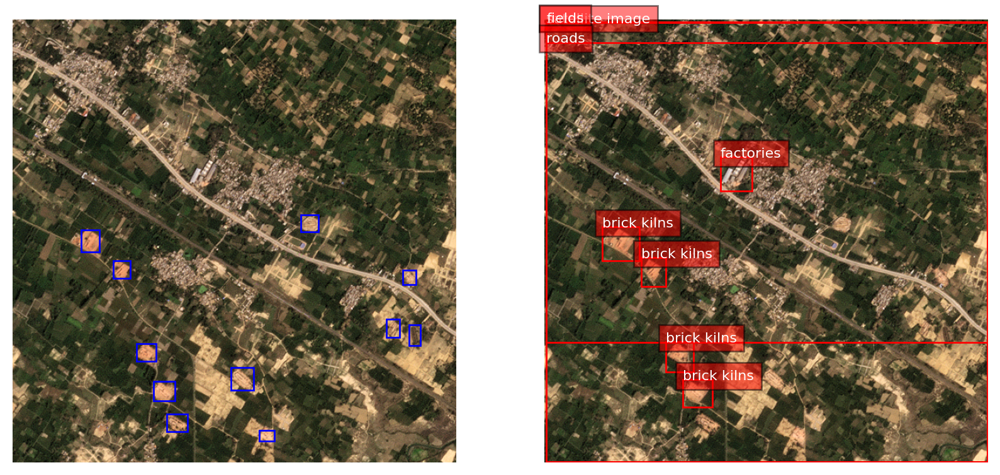

{'bboxes': [[2.240000009536743, 2.879999876022339, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [95.68000030517578, 343.3599853515625, 144.95999145507812, 393.2799987792969]], 'labels': ['satellite image', 'fields', 'brick kilns']}


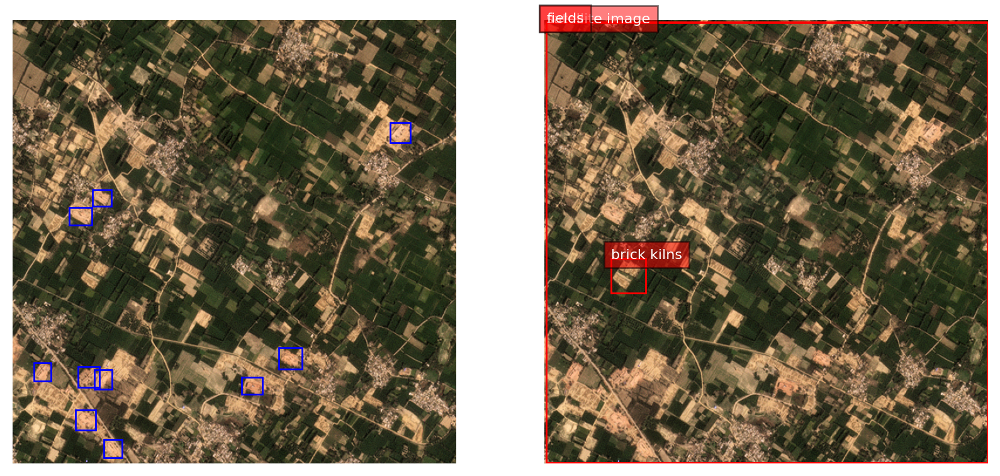

{'bboxes': [[2.240000009536743, 2.879999876022339, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [339.5199890136719, 441.91998291015625, 395.1999816894531, 518.0800170898438]], 'labels': ['satellite image', 'fields', 'brick kilns']}


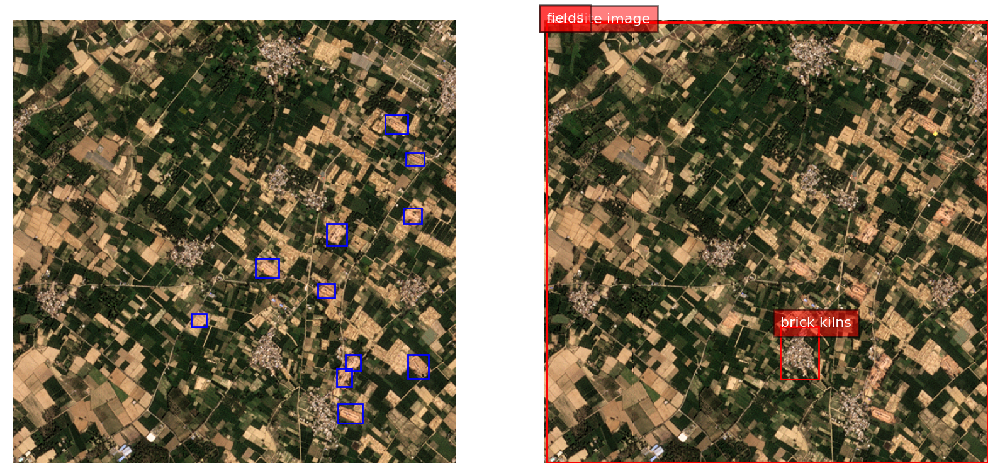

{'bboxes': [[2.879999876022339, 2.879999876022339, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [477.7599792480469, 137.9199981689453, 594.8800048828125, 226.87998962402344]], 'labels': ['satellite image', 'fields', 'brick kilns']}


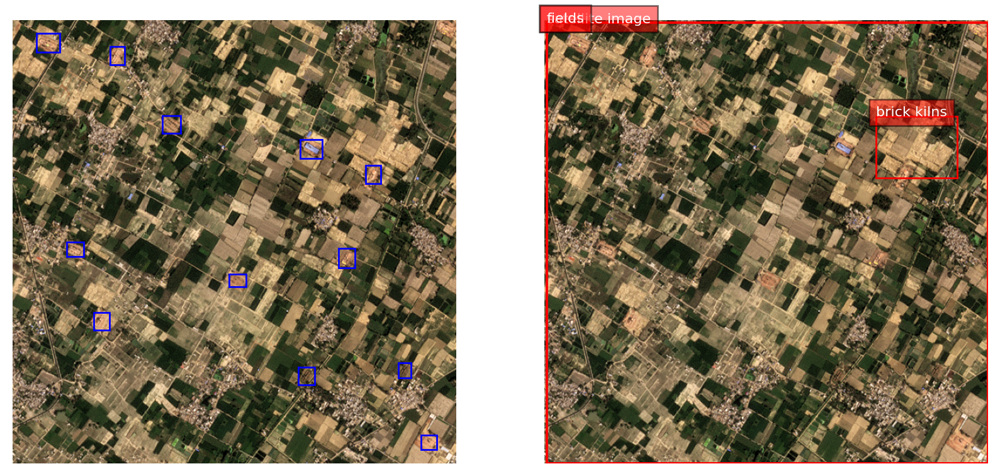

{'bboxes': [[2.879999876022339, 2.879999876022339, 637.760009765625, 638.3999633789062], [2.240000009536743, 2.240000009536743, 637.760009765625, 638.3999633789062], [319.67999267578125, 445.7599792480469, 401.6000061035156, 548.7999877929688]], 'labels': ['satellite image', 'fields', 'brick kilns']}


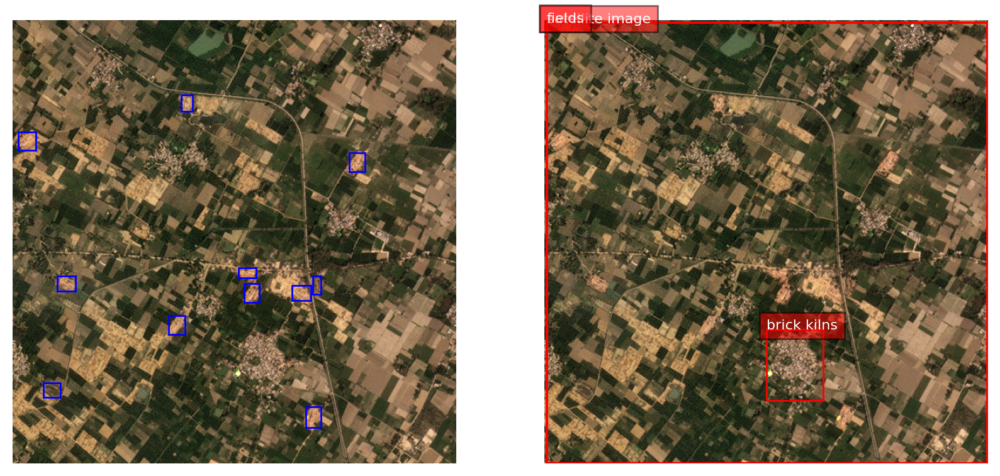

{'bboxes': [[2.879999876022339, 2.879999876022339, 637.760009765625, 638.3999633789062], [2.240000009536743, 2.879999876022339, 638.3999633789062, 639.0399780273438], [303.67999267578125, 1.5999999046325684, 639.0399780273438, 322.239990234375], [1.5999999046325684, 456.6399841308594, 322.239990234375, 639.6799926757812], [133.44000244140625, 252.47999572753906, 233.9199981689453, 374.0799865722656]], 'labels': ['satellite image', 'fields', 'roads', 'roads', 'brick kilns']}


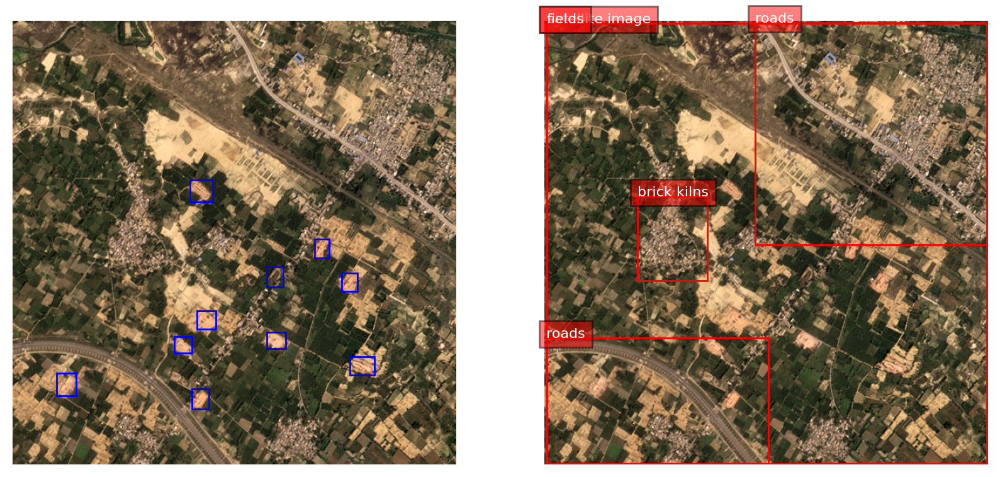

{'bboxes': [[2.240000009536743, 2.240000009536743, 638.3999633789062, 638.3999633789062], [2.240000009536743, 1.5999999046325684, 638.3999633789062, 639.0399780273438], [307.5199890136719, 326.7200012207031, 390.7200012207031, 413.7599792480469]], 'labels': ['satellite image', 'fields', 'brick kilns']}


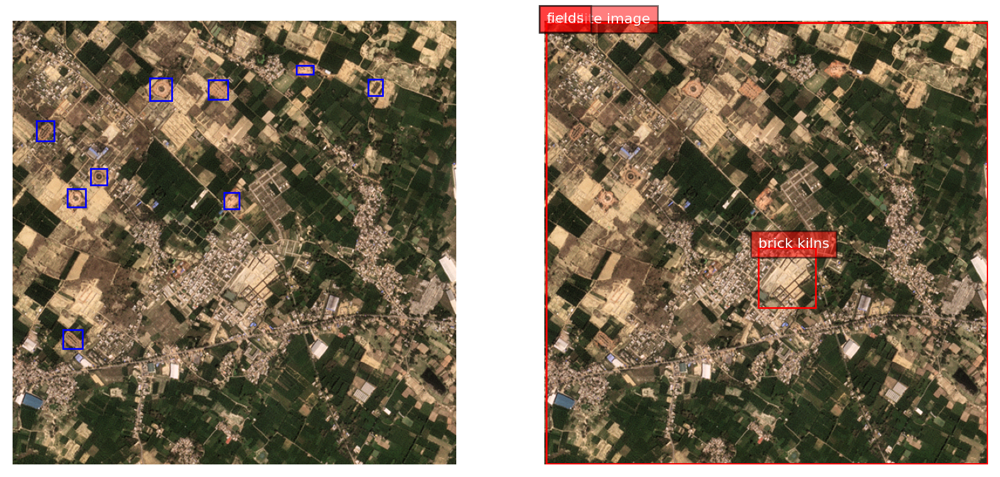

{'bboxes': [[2.240000009536743, 2.879999876022339, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [295.3599853515625, 411.8399963378906, 397.1199951171875, 514.8800048828125]], 'labels': ['satellite image', 'fields', 'brick kilns']}


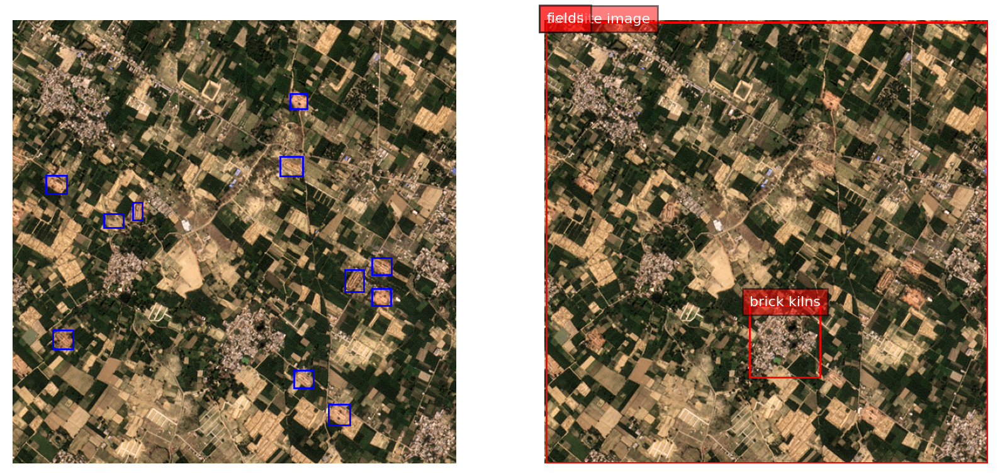

{'bboxes': [[2.240000009536743, 2.879999876022339, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.240000009536743, 638.3999633789062, 638.3999633789062], [535.3599853515625, 221.75999450683594, 639.0399780273438, 306.239990234375]], 'labels': ['satellite image', 'fields', 'brick kilns']}


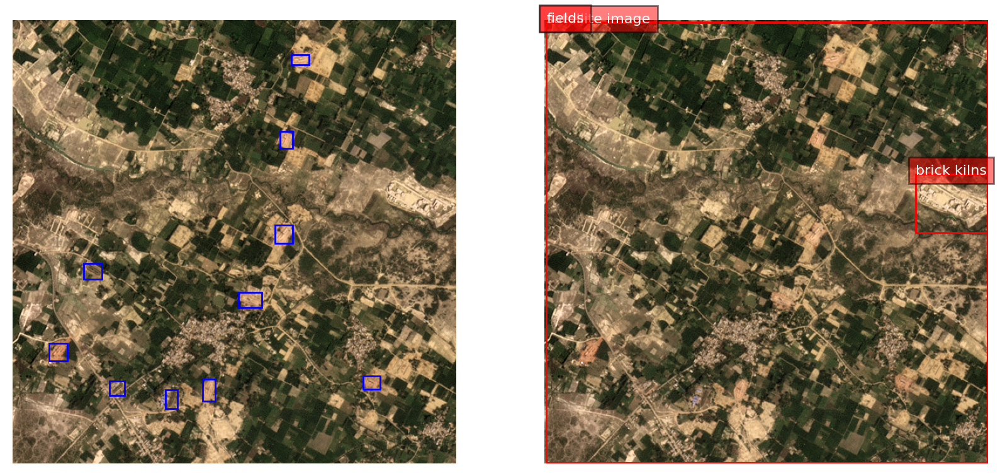

{'bboxes': [[0.3199999928474426, 0.3199999928474426, 639.6799926757812, 639.6799926757812], [0.3199999928474426, 0.9599999785423279, 639.6799926757812, 639.6799926757812], [0.3199999928474426, 448.3199768066406, 639.6799926757812, 576.9599609375], [288.9599914550781, 210.239990234375, 385.6000061035156, 308.79998779296875]], 'labels': ['satellite image', 'fields', 'roads', 'brick kilns']}


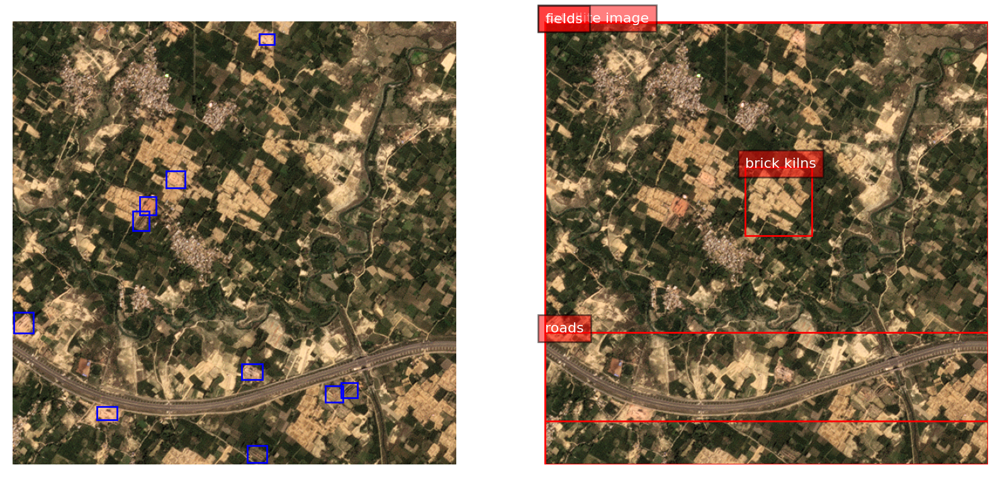

{'bboxes': [[2.240000009536743, 2.240000009536743, 637.760009765625, 637.760009765625], [2.240000009536743, 2.240000009536743, 638.3999633789062, 638.3999633789062], [2.240000009536743, 2.879999876022339, 638.3999633789062, 638.3999633789062], [2.240000009536743, 242.239990234375, 638.3999633789062, 636.47998046875], [265.91998291015625, 515.5199584960938, 319.03997802734375, 580.7999877929688]], 'labels': ['satellite image', 'fields', 'factories', 'roads', 'brick kilns']}


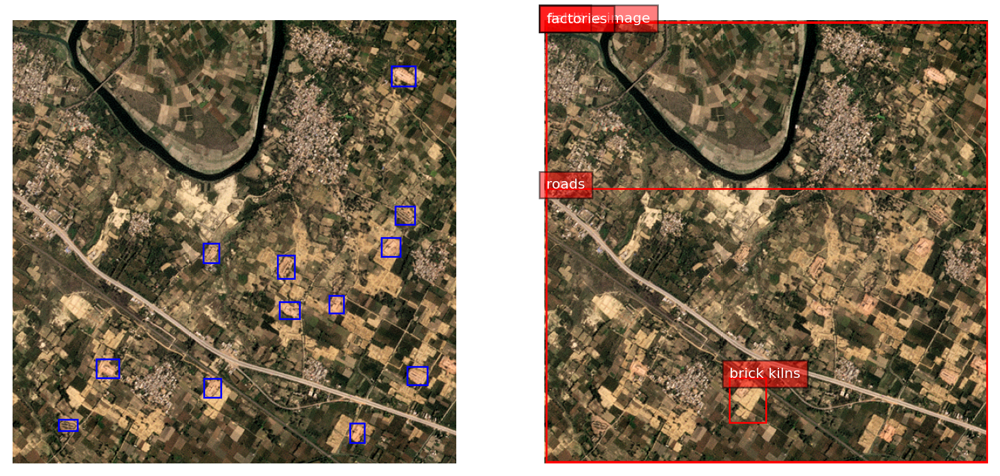

In [10]:
taskp = "<CAPTION_TO_PHRASE_GROUNDING>"
textp = "satellite image showing fields, factories, roads, a river, and brick kilns"

print("Text prompt:", taskp + textp)

for i in range(15):
    im_path = images_folder + "/" + image_names[i]
    lab_path = aa_labels_folder + "/" + label_names[i]
    gt_num, pred_num, num_corr, kilns_found = compare_gt_pred(im_path, lab_path, taskp, textp, 0.1, plot_results = True)

In [ ]:
testing_list = [1, 6, 11, 12, 13]
gt_kilns = 155 # calculated through previous tests
pred_kilns = [0]*15
corr_preds = [0]*15
kilns_found_list = [0]*15
iou_th = 0.1
for x in testing_list:
    print()
    print("Text prompt:", task_prompts[x] + text_prompts[x])
    print("IoU threshold:", iou_th)
    for i in range(15):
        im_path = images_folder + "/" + image_names[i]
        lab_path = aa_labels_folder + "/" + label_names[i]
        gt_num, pred_num, num_corr, kilns_found = compare_gt_pred(im_path, lab_path, task_prompts[x], text_prompts[x], iou_th, plot_results = True)
        pred_kilns[x]+=pred_num
        corr_preds[x]+=num_corr
        kilns_found_list[x]+=kilns_found
    print('Actual number of kilns =', gt_kilns)
    print("Predicted number of kilns =", pred_kilns[x])
    print("Number of predictions that matched with ground truth kilns =", corr_preds[x])
    print("Number of kilns identified correctly =", kilns_found_list[x])
    print()
    if corr_preds[x]!=0:
        prec = corr_preds[x]/pred_kilns[x]
        print("Precision =", prec)
        rec = kilns_found_list[x]/gt_kilns
        print("Recall =", rec)
        f1 = 2*prec*rec/(prec+rec)
        print("F1 score =", f1)


Text prompt: <OPEN_VOCABULARY_DETECTION>brick kiln with chimney
IoU threshold: 0.1


In [ ]:
gt_kilns = 155 # calculated through previous tests
pred_kilns = [0]*15
corr_preds = [0]*15
kilns_found_list = [0]*15
iou_th = 0.1
for x in range(15):
    print()
    print("Text prompt:", task_prompts[x] + text_prompts[x])
    print("IoU threshold:", iou_th)
    for i in range(15):
        im_path = images_folder + "/" + image_names[i]
        lab_path = aa_labels_folder + "/" + label_names[i]
        if i==0:
            gt_num, pred_num, num_corr, kilns_found = compare_gt_pred(im_path, lab_path, task_prompts[x], text_prompts[x], iou_th, plot_results = True)
        else:
            gt_num, pred_num, num_corr, kilns_found = compare_gt_pred(im_path, lab_path, task_prompts[x], text_prompts[x], iou_th)
        pred_kilns[x]+=pred_num
        corr_preds[x]+=num_corr
        kilns_found_list[x]+=kilns_found
    print('Actual number of kilns =', gt_kilns)
    print("Predicted number of kilns =", pred_kilns[x])
    print("Number of predictions that matched with ground truth kilns =", corr_preds[x])
    print("Number of kilns identified correctly =", kilns_found_list[x])
    print()
    if corr_preds[x]!=0:
        prec = corr_preds[x]/pred_kilns[x]
        print("Precision =", prec)
        rec = kilns_found_list[x]/gt_kilns
        print("Recall =", rec)
        f1 = 2*prec*rec/(prec+rec)
        print("F1 score =", f1)


Text prompt: <OPEN_VOCABULARY_DETECTION>brick kiln with chimney
IoU threshold: 0.7


{'bboxes': [[138.55999755859375, 256.9599914550781, 167.36000061035156, 301.7599792480469]], 'bboxes_labels': ['brick kiln with chimney'], 'polygons': [], 'polygons_labels': []}


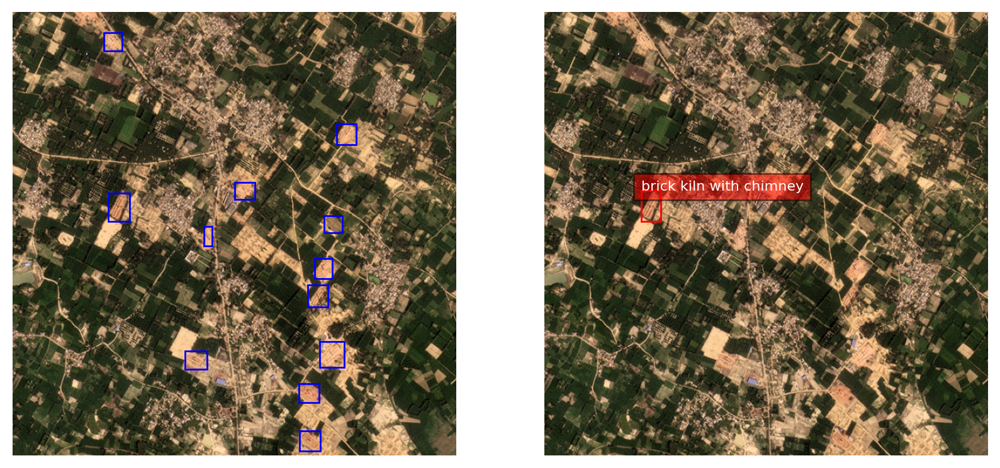

{'bboxes': [[344.0, 482.8799743652344, 383.67999267578125, 518.0800170898438]], 'bboxes_labels': ['brick kiln with chimney'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[540.47998046875, 0.3199999928474426, 639.6799926757812, 94.4000015258789]], 'bboxes_labels': ['brick kiln with chimney'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[353.6000061035156, 293.44000244140625, 386.239990234375, 332.47998046875]], 'bboxes_labels': ['brick kiln with chimney'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[83.5199966430664, 300.47998046875, 133.44000244140625, 344.6399841308594]], 'bboxes_labels': ['brick kiln with chimney'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[332.47998046875, 516.1599731445312, 367.67999267578125, 544.3200073242188]], 'bboxes_labels': ['brick kiln with chimney'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[350.3999938964844, 18.8799991607666, 427.8399963378906, 93.75999450683594]], 'bboxes_labels': ['brick kiln with chimney'], 'p

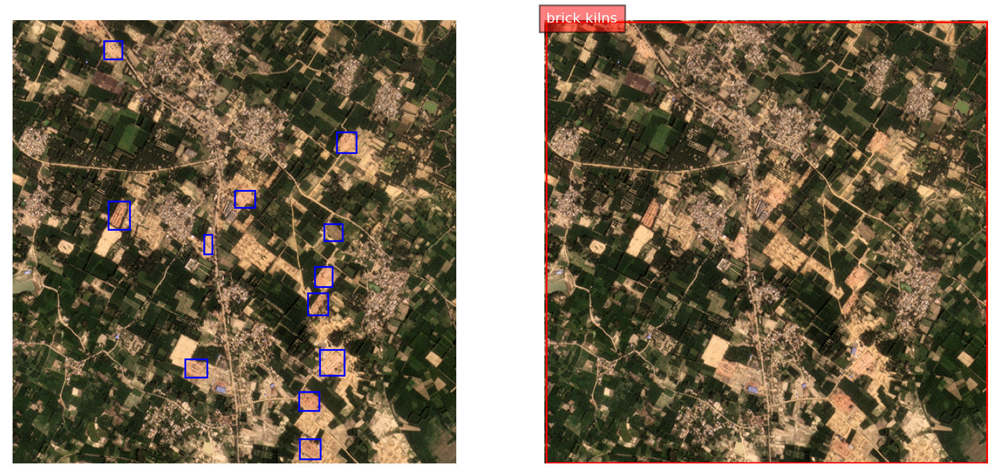

{'bboxes': [[2.240000009536743, 2.240000009536743, 637.760009765625, 638.3999633789062]], 'bboxes_labels': ['brick kilns'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[2.240000009536743, 2.240000009536743, 637.760009765625, 638.3999633789062]], 'bboxes_labels': ['brick kilns'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[352.32000732421875, 292.1600036621094, 388.79998779296875, 335.67999267578125]], 'bboxes_labels': ['brick kilns'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[82.87999725341797, 299.1999816894531, 136.0, 346.55999755859375]], 'bboxes_labels': ['brick kilns'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[2.240000009536743, 2.240000009536743, 637.760009765625, 638.3999633789062]], 'bboxes_labels': ['brick kilns'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[2.240000009536743, 2.240000009536743, 637.760009765625, 638.3999633789062]], 'bboxes_labels': ['brick kilns'], 'polygons': [], 'polygons_labels': []}
{'bboxes': [[2.2400000095367

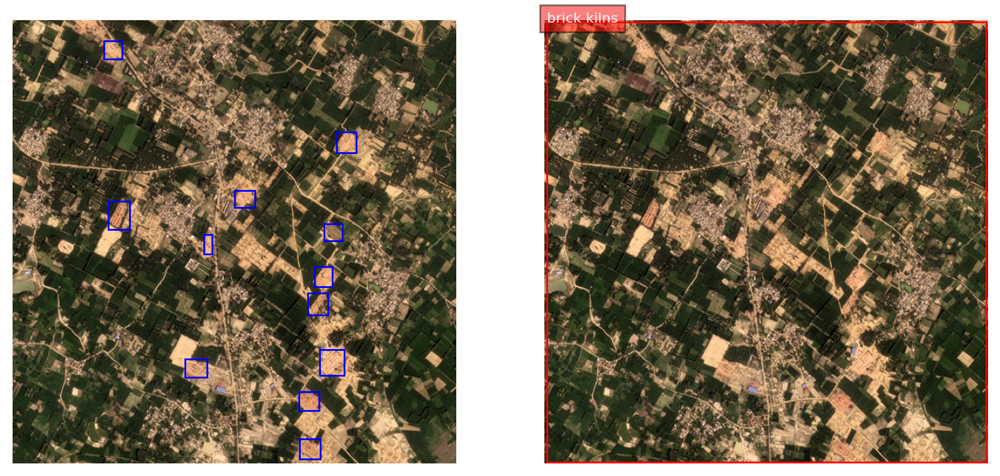

{'bboxes': [[2.879999876022339, 2.879999876022339, 637.1199951171875, 637.760009765625]], 'labels': ['brick kilns']}
{'bboxes': [[2.879999876022339, 2.240000009536743, 637.1199951171875, 637.760009765625]], 'labels': ['brick kilns']}
{'bboxes': [[2.879999876022339, 2.879999876022339, 637.760009765625, 637.1199951171875], [353.6000061035156, 292.79998779296875, 387.5199890136719, 334.3999938964844]], 'labels': ['brick kilns', 'chimneys']}
{'bboxes': [[2.879999876022339, 2.879999876022339, 637.1199951171875, 637.1199951171875]], 'labels': ['brick kilns']}
{'bboxes': [[2.879999876022339, 2.879999876022339, 637.1199951171875, 637.1199951171875]], 'labels': ['brick kilns']}
{'bboxes': [[2.879999876022339, 2.879999876022339, 637.1199951171875, 637.1199951171875]], 'labels': ['brick kilns']}
{'bboxes': [[3.5199999809265137, 2.879999876022339, 637.1199951171875, 637.1199951171875]], 'labels': ['brick kilns']}
{'bboxes': [[2.879999876022339, 2.879999876022339, 637.1199951171875, 637.11999511718

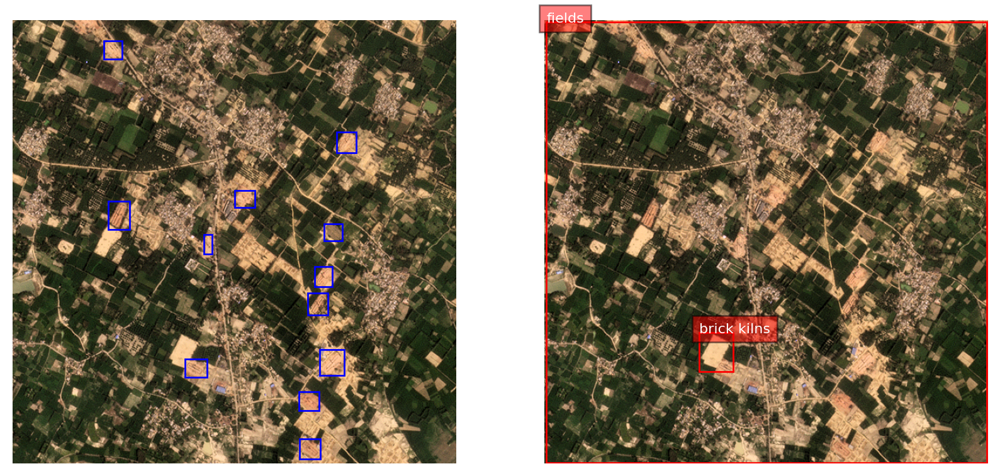

{'bboxes': [[2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [445.7599792480469, 301.7599792480469, 484.1600036621094, 340.79998779296875], [1.5999999046325684, 1.5999999046325684, 220.47999572753906, 450.8800048828125], [155.83999633789062, 383.03997802734375, 294.0799865722656, 495.03997802734375]], 'labels': ['fields', 'factory', 'roads', 'brick kilns']}
{'bboxes': [[2.240000009536743, 2.240000009536743, 637.760009765625, 638.3999633789062], [2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [82.87999725341797, 379.8399963378906, 126.39999389648438, 418.8800048828125], [525.1199951171875, 180.1599884033203, 560.9599609375, 224.95999145507812], [189.75999450683594, 294.0799865722656, 224.3199920654297, 335.67999267578125], [447.67999267578125, 71.36000061035156, 482.239990234375, 107.19999694824219]], 'labels': ['fields', 'factory', 'brick kilns', 'brick kilns', 'brick kilns', 'brick kilns']}
{'bboxes': [[2.240000009536743, 2.24

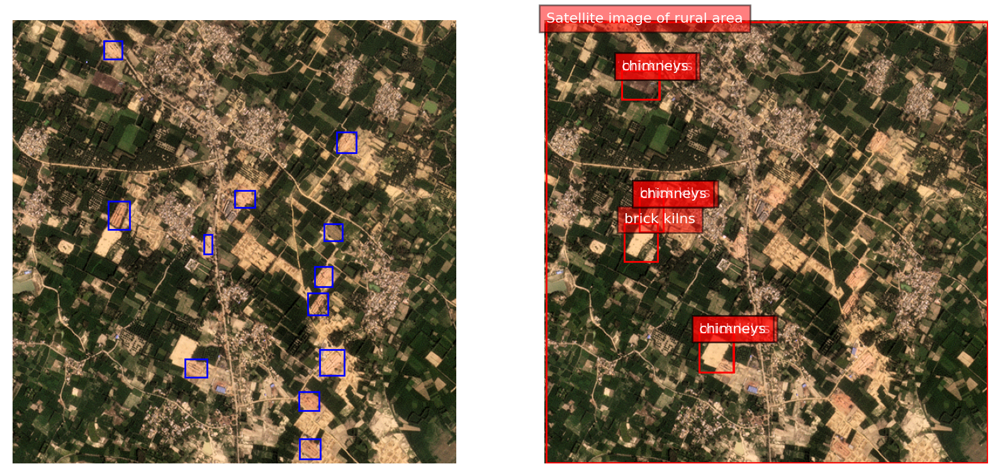

{'bboxes': [[2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [445.7599792480469, 301.7599792480469, 484.79998779296875, 341.44000244140625], [297.2799987792969, 2.240000009536743, 639.0399780273438, 295.3599853515625], [155.1999969482422, 383.03997802734375, 294.0799865722656, 495.67999267578125], [114.23999786376953, 275.5199890136719, 228.79998779296875, 364.47998046875], [244.1599884033203, 2.240000009536743, 297.2799987792969, 53.439998626708984], [1.5999999046325684, 1.5999999046325684, 220.47999572753906, 452.1600036621094]], 'labels': ['Satellite image of rural area', 'factories', 'trees', 'brick kilns', 'brick kilns', 'chimneys', 'roads']}
{'bboxes': [[2.240000009536743, 2.240000009536743, 638.3999633789062, 639.0399780273438], [2.240000009536743, 2.879999876022339, 638.3999633789062, 638.3999633789062], [532.7999877929688, 467.5199890136719, 633.9199829101562, 550.0800170898438], [82.87999725341797, 379.8399963378906, 127.04000091552734, 418.880004

In [24]:
pr_range = [1, 6, 11, 12, 13]
gt_kilns = 155 # calculated through previous tests
pred_kilns = [0]*15
corr_preds = [0]*15
kilns_found_list = [0]*15
iou_th = 0.7
for x in pr_range:
    print()
    print("Text prompt:", task_prompts[x] + text_prompts[x])
    print("IoU threshold:", iou_th)
    for i in range(15):
        im_path = images_folder + "/" + image_names[i]
        lab_path = aa_labels_folder + "/" + label_names[i]
        if i==0:
            gt_num, pred_num, num_corr, kilns_found = compare_gt_pred(im_path, lab_path, task_prompts[x], text_prompts[x], iou_th, plot_results = True)
        else:
            gt_num, pred_num, num_corr, kilns_found = compare_gt_pred(im_path, lab_path, task_prompts[x], text_prompts[x], iou_th)
        pred_kilns[x]+=pred_num
        corr_preds[x]+=num_corr
        kilns_found_list[x]+=kilns_found
    print('Actual number of kilns =', gt_kilns)
    print("Predicted number of kilns =", pred_kilns[x])
    print("Number of predictions that matched with ground truth kilns =", corr_preds[x])
    print("Number of kilns identified correctly =", kilns_found_list[x])
    print()
    if corr_preds[x]!=0:
        prec = corr_preds[x]/pred_kilns[x]
        print("Precision =", prec)
        rec = kilns_found_list[x]/gt_kilns
        print("Recall =", rec)
        f1 = 2*prec*rec/(prec+rec)
        print("F1 score =", f1)